# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## Importing  Packages

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import glob
from os import listdir
from os.path import isfile, join
import math
%matplotlib inline

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

## Camera Calibration Matrix and Distortion Coefficients


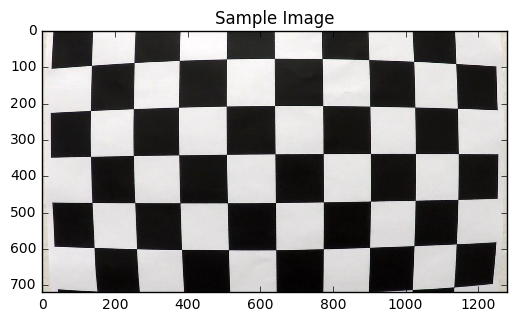

In [2]:
#getting chessboard images for amera callibration 
images = glob.glob('camera_cal/calibration*.jpg')
plt.title("Sample Image")
plt.imshow(plt.imread(images[0]))

In [3]:
nx = 9
ny = 6

objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

images_with_corners = []
# Stepping through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
    # Finding the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    if(ret==True):
        found_corners = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        images_with_corners.append(found_corners)

        objpoints.append(objp)
        imgpoints.append(corners)

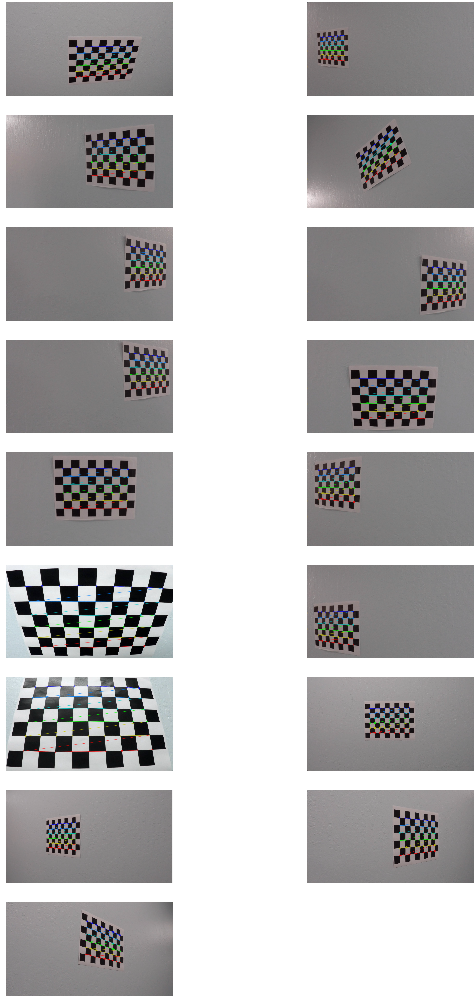

In [4]:
# Drawing Corners on images with nx=9, ny=6. Some images are ignored here as these are enough.  
row = 10
col = 2
plt.figure(figsize=(50,100))
for i in range(len(images_with_corners)):
    plt.subplot(row, col, i+1)
    plt.axis('off')
    plt.imshow(images_with_corners[i])
            
plt.show()

In [5]:
# Test undistortion on an image
img = plt.imread(images[9])
img_size = (img.shape[1], img.shape[0])

In [6]:
# Doing camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

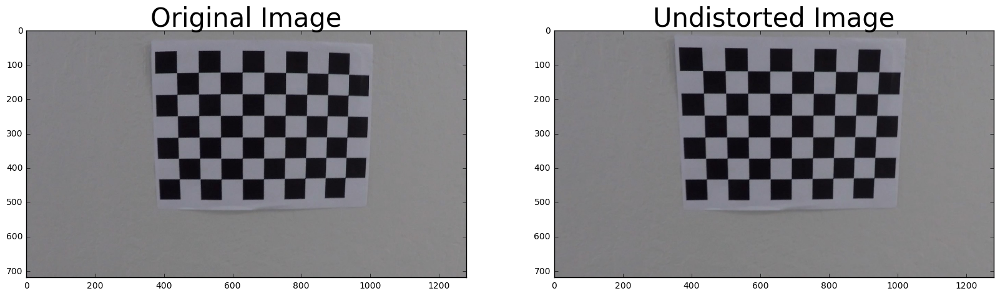

In [7]:
dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/test_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

## Defining Helper Functions

In [8]:
def load_image(image_path):
    """load the image from the given path."""
    return mpimg.imread(image_path)

In [9]:
def save_image(dir_name, name, img):
    """save the image in the directory"""
    #cv2.imwrite(join(dir_name, name), img)
    plt.imsave(join(dir_name, name), img)

In [10]:
def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [11]:
def undistort_image(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

In [12]:
def warp_image(image,src,dst):
    img_size = (image.shape[1], image.shape[0])

    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(image, M, img_size)
    
    Minv = cv2.getPerspectiveTransform(dst , src) 
    
    return warped,Minv

In [13]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


In [14]:
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x',sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    # Return the result
    return binary_output

In [15]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    # Here I'm suppressing annoying error messages
    with np.errstate(divide='ignore', invalid='ignore'):
        absgraddir = np.absolute(np.arctan(sobely/sobelx))
        dir_binary =  np.zeros_like(absgraddir)
        dir_binary[(absgraddir > thresh[0]) & (absgraddir < thresh[1])] = 1
    # Return the binary image
    return dir_binary

In [16]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag > mag_thresh[0]) & (gradmag < mag_thresh[1])] = 1
    # Return the binary image
    return mag_binary

In [17]:
def select_yellow(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    lower_blue = np.array([20,60,60])
    upper_blue = np.array([38,174, 250])
    mask = cv2.inRange(hsv, lower_blue, upper_blue)
    
    return mask

In [18]:
def select_white(image):
    lower_white = np.array([202,202,202])
    upper_white = np.array([255,255,255])
    mask = cv2.inRange(image, lower_white, upper_white)

    return mask

In [19]:
def gaussian_blur(img, kernel=5):
    blur = cv2.GaussianBlur(img,(kernel,kernel),0)
    return blur

### process_image function

* Undistort the image
* Define the souce and destination points to get a warped image
* get the binary image for yellow pixels in the warped image
* get the binary image for white pixels in the warped image
* create a binary image containing yellow and white pixels found earlier
* divide the image in two parts vertically to get the x,y axis for points representing left and right lanes
* adding the x,y points to the lanes to extend the lanes to top and bottom of the binary image
* fit the points to get lanes including curvedd ones
* calculate the curvature of left and right lanes
* calculate the lane deviation from the center
* draw the lanes on the warped image
* unwarped the warped image to get the image with lanes drawn on it
* add the curvature and lane deviation information to the lanes image
* return the intermediate and final results to show later

* pipeline is comparatively fast, less computations and good results even on challenge video
* Did not use gradient thresholding as those were contributing noise and were resulting in doing extra calculations like removing noise, histogram calculations   

In [20]:
def process_image(image):
    r,g,b = 55,75,83
    image = undistort_image(image, mtx, dist)
    image = gaussian_blur(image, kernel=5)
    img_shape = image.shape

    width = img_shape[1]
    height = img_shape[0]
    
    src = np.float32([[math.floor(width/7.5) ,height],
                    [math.floor(width/2.46), math.floor(height/1.43)],
                    [width-80 ,height],
                    [math.floor(width/1.58) , math.floor(height/1.43)]])

    dst = np.float32([[math.floor(width/7.5) ,height],
                            [math.floor(width/7.5) ,0], 
                            [width-80 , height], 
                            [width-80 , 0]])
    
    warp,Minv  = warp_image(image,src,dst)
    yellow = select_yellow(warp)
    white = select_white(warp)

    combined_binary = np.zeros_like(yellow)
    combined_binary[(yellow >= 1) | (white >= 1)] = 1    
    
    lmax = 600
    lmin = 0
    rmin = 800
    rmax = 1280

        
    lefty,leftx = (combined_binary[:,lmin:lmax]==1).nonzero()
    leftx = leftx + lmin
    righty,rightx = (combined_binary[:,rmin:rmax]==1).nonzero()
    rightx = rightx + rmin

    lefty = np.insert(lefty,len(lefty),720) 
    leftx = np.insert(leftx,len(leftx),leftx[len(leftx)-1])

    lefty = np.insert(lefty,0,0) 
    leftx = np.insert(leftx,0,leftx[0])

    
    righty = np.insert(righty,len(righty),720) 
    rightx = np.insert(rightx,len(rightx),rightx[len(rightx)-1])

    righty = np.insert(righty,0,0) 
    rightx = np.insert(rightx,0,rightx[0])



    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    left_fitx = left_fit[0]*lefty**2 + left_fit[1]*lefty + left_fit[2]
    right_fitx = right_fit[0]*righty**2 + right_fit[1]*righty + right_fit[2]

    
    ly_eval = np.max(lefty)
    ry_eval = np.max(righty)
    left_curverad = ((1 + (2*left_fit[0]*ly_eval + left_fit[1])**2)**1.5) \
                                 /np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*ry_eval + right_fit[1])**2)**1.5) \
                                    /np.absolute(2*right_fit[0])

    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    left_curverad = ((1 + (2*left_fit_cr[0]*ly_eval + left_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*ry_eval + right_fit_cr[1])**2)**1.5) \
                                    /np.absolute(2*right_fit_cr[0])

    warp_zero = np.zeros_like(combined_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, lefty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, righty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (26,182, 249 ))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)    

    # meters from center
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    screen_middel_pixel = image.shape[1]/2
    left_lane_pixel = leftx[0]    # x position for left lane
    right_lane_pixel = rightx[0]   # x position for right lane
    car_middle_pixel = int((right_lane_pixel + left_lane_pixel)/2)
    pixels_off_center = screen_middel_pixel - car_middle_pixel
    meters_off_center = xm_per_pix * pixels_off_center 

    kernel = np.ones((5,5),np.float32)/25
    result = cv2.filter2D(result,-1,kernel)
    
    

    result[:150,:,0] = r
    result[:150,:,1] = g
    result[:150,:,2] = b

    
    str1 = "       Curvature: L = "+ str(float("{0:.2f}".format(left_curverad)))+", R = "+str(float("{0:.2f}".format(right_curverad)))
    if(meters_off_center<0):
        str2 = "        Lane Deviation left of center: "+str(float("{0:.2f}".format(abs(meters_off_center))))+" m"
    elif(meters_off_center>=0):
        str2 = "        Lane Deviation right of center: "+str(float("{0:.2f}".format(meters_off_center)))+" m"



    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result,str1,(20,50), font, 1.3,(183,200,207),2)
    cv2.putText(result,str2,(20,100), font, 1.3,(183,200,207),2) 

    
    
    return image,warp,combined_binary,color_warp,result
    

## Test Images

In [21]:
images = glob.glob('test_images/*.jpg')

In [22]:
test_results = []
for i in range(len(images)):
    image,warp,combined_binary,color_warp,result = process_image(plt.imread(images[i]))
    test_results.append(image)
    test_results.append(warp)
    test_results.append(combined_binary)
    test_results.append(color_warp)
    test_results.append(result)
    plt.imsave('output_images/'+str(i)+'.jpg',result)

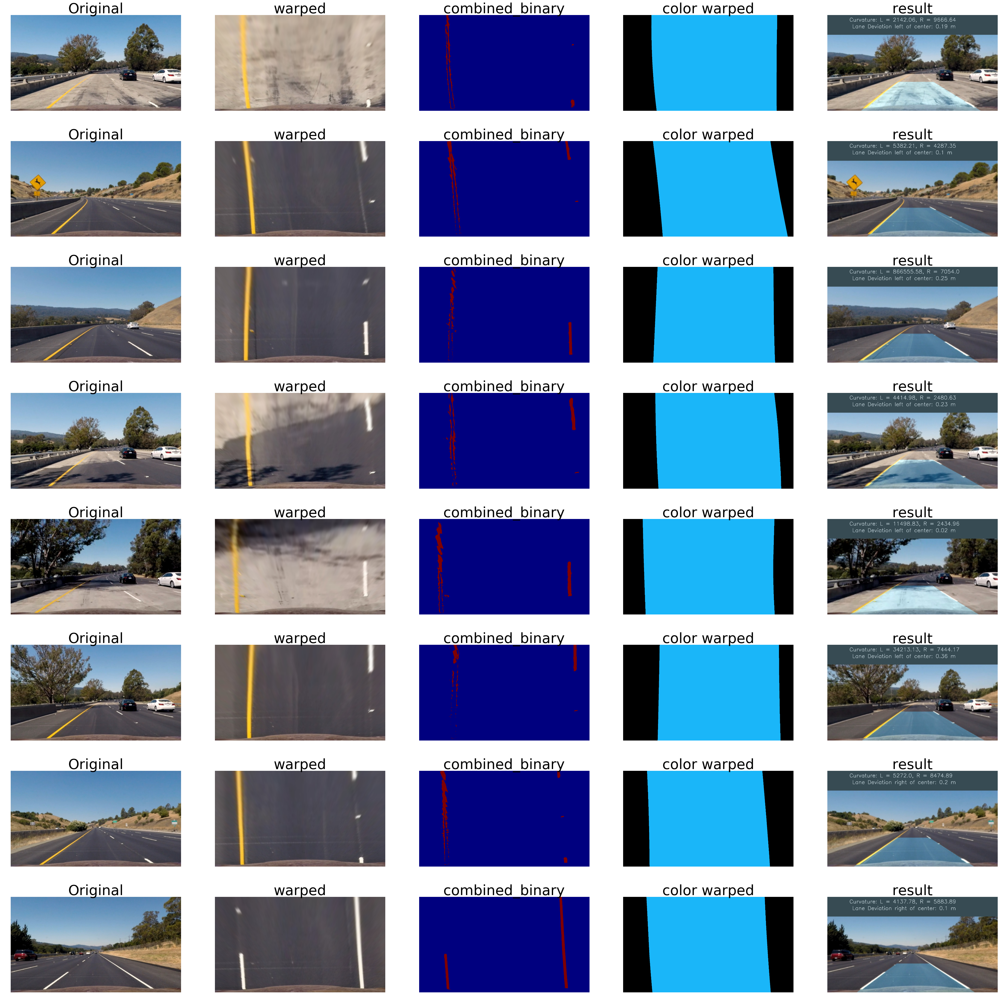

In [23]:
title = {0:'Original',1:'warped',2:'combined_binary',3:'color warped',4:'result'}

row = 8
col = 5
plt.figure(figsize=(50,50))
for i in range(40):
    plt.subplot(row, col, i+1)
    plt.axis('off')
    plt.title(title[i%5],size=40)
    plt.imshow(test_results[i])

    
plt.show()

## Videos

### process_video function
* declare the global variables to store lanes from previous frames
* Undistort the image
* Define the souce and destination points to get a warped image
* get the binary image for yellow pixels in the warped image
* get the binary image for white pixels in the warped image
* create a binary image containing yellow and white pixels found earlier
* intelligently searching the lanes points by divide the image in two parts vertically by getting the information about lanes in previous frames, to get the x,y axis for points representing left and right lanes
* adding the x,y points to the lanes to extend the lanes to top and bottom of the binary image
* fit the points to get lanes including curvedd ones, also giving half weightage to lanes from last frame
* A second order polynomial was fit to each line: f(y) = Ay^2 + By + C As discused in lesson 13 the resulting coeficients have the following meaning:
* A gives the curvature of the lane line
* B gives the heading or direction that the line is pointing
* C gives the position of the line based on how far away it is from the very left of an image (y = 0)
* if the new lanes are significantly different then the lanes from previous frames, lanes from previous frames are used 
* calculate the curvature of left and right lanes
* calculate the lane deviation from the center
* draw the lanes on the warped image
* unwarped the warped image to get the image with lanes drawn on it
* add the curvature and lane deviation information to the lanes image
* save the lanes information for next frames
* return the frame containinginormation about lanes, curvature and vehicle deviatation from center  

* pipeline is comparatively fast, less computations and good results even on challenge video
* Did not use gradient thresholding as those were contributing noise and were resulting in doing extra calculations like removing noise, histogram and slidin window calculations   

In [24]:
def process_video(image):
    
    r,g,b = 55,75,83
    
    global last_lanes
    global prev_left_fit  
    global prev_right_fit
    global first_frame

    image = undistort_image(image, mtx, dist)
    image = gaussian_blur(image, kernel=5)
    img_shape = image.shape

    width = img_shape[1]
    height = img_shape[0]
    
    src = np.float32([[math.floor(width/7.5) ,height],
                    [math.floor(width/2.46), math.floor(height/1.43)],
                    [width-80 ,height],
                    [math.floor(width/1.58) , math.floor(height/1.43)]])

    dst = np.float32([[math.floor(width/7.5) ,height],
                            [math.floor(width/7.5) ,0], 
                            [width-80 , height], 
                            [width-80 , 0]])
    
    warp,Minv  = warp_image(image,src,dst)
    yellow = select_yellow(warp)
    white = select_white(warp)

    combined_binary = np.zeros_like(yellow)
    combined_binary[(yellow >= 1) | (white >= 1)] = 1    
    
    lmax = 600
    lmin = 0
    rmin = 800
    rmax = 1280
    
    if(first_frame == 0):
        lmin = np.min(last_lanes[0]) - 30 
        lmax = np.max(last_lanes[0]) + 30
        
        rmin = np.min(last_lanes[2]) - 30
        rmax = np.max(last_lanes[2]) + 30
        
    lefty,leftx = (combined_binary[:,lmin:lmax]==1).nonzero()
    leftx = leftx + lmin
    righty,rightx = (combined_binary[:,rmin:rmax]==1).nonzero()
    rightx = rightx + rmin


    if(len(leftx)==0):
        leftx = last_lanes[0]
        lefty = last_lanes[1]
        
            
    elif(len(leftx)>0):                    
        lefty = np.insert(lefty,len(lefty),720) 
        leftx = np.insert(leftx,len(leftx),leftx[len(leftx)-1])

        lefty = np.insert(lefty,0,0) 
        leftx = np.insert(leftx,0,leftx[0])
                    
    if(len(rightx)==0):
        rightx = last_lanes[2]
        righty = last_lanes[3]
    elif(len(rightx)>0):                    

        righty = np.insert(righty,len(righty),720) 
        rightx = np.insert(rightx,len(rightx),rightx[len(rightx)-1])

        righty = np.insert(righty,0,0) 
        rightx = np.insert(rightx,0,rightx[0])


    last_lanes = [leftx,lefty,rightx,righty]


    # Fit a second order polynomial to each lane line
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    

    if(first_frame == 0):
        err_p_R = np.sum((right_fit-prev_right_fit)**2)/np.sum(prev_right_fit**2)
        err_p_R = np.sqrt(err_p_R)
        if(err_p_R>0.05):
            right_fit = prev_right_fit
            left_fit =  prev_left_fit
        else:
            right_fit = .5*right_fit+.5* prev_right_fit
            left_fit =  .5* left_fit+.5* prev_left_fit        
    
    prev_right_fit = right_fit
    prev_left_fit =  left_fit

    
    left_fitx = left_fit[0]*lefty**2 + left_fit[1]*lefty + left_fit[2]
    right_fitx = right_fit[0]*righty**2 + right_fit[1]*righty + right_fit[2]

    
    ly_eval = np.max(lefty)
    ry_eval = np.max(righty)
    left_curverad = ((1 + (2*left_fit[0]*ly_eval + left_fit[1])**2)**1.5) \
                                 /np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*ry_eval + right_fit[1])**2)**1.5) \
                                    /np.absolute(2*right_fit[0])

    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    left_curverad = ((1 + (2*left_fit_cr[0]*ly_eval + left_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*ry_eval + right_fit_cr[1])**2)**1.5) \
                                    /np.absolute(2*right_fit_cr[0])

    warp_zero = np.zeros_like(combined_binary).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, lefty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, righty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (26,182, 249 ))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)    

    # meters from center
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    screen_middel_pixel = image.shape[1]/2
    left_lane_pixel = leftx[0]    # x position for left lane
    right_lane_pixel = rightx[0]   # x position for right lane
    car_middle_pixel = int((right_lane_pixel + left_lane_pixel)/2)
    pixels_off_center = screen_middel_pixel - car_middle_pixel
    meters_off_center = xm_per_pix * pixels_off_center 

    kernel = np.ones((5,5),np.float32)/25
    result = cv2.filter2D(result,-1,kernel)
    
    

    result[:150,:,0] = r
    result[:150,:,1] = g
    result[:150,:,2] = b

    
    str1 = "       Curvature: L = "+ str(float("{0:.2f}".format(left_curverad)))+", R = "+str(float("{0:.2f}".format(right_curverad)))
    if(meters_off_center<0):
        str2 = "        Lane Deviation left of center: "+str(float("{0:.2f}".format(abs(meters_off_center))))+" m"
    elif(meters_off_center>=0):
        str2 = "        Lane Deviation right of center: "+str(float("{0:.2f}".format(meters_off_center)))+" m"


    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result,str1,(20,50), font, 1.3,(183,200,207),2)
    cv2.putText(result,str2,(20,100), font, 1.3,(183,200,207),2) 

    first_frame = 0
    
    return result

In [25]:
first_frame = 1
project_video_output = 'output_videos/project_video_output.mp4'
clip = VideoFileClip('videos/project_video.mp4')

project_video_output_clip = clip.fl_image(process_video)
%time project_video_output_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video output_videos/project_video_output.mp4
[MoviePy] Writing video output_videos/project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [03:27<00:00,  6.33it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/project_video_output.mp4 

Wall time: 3min 29s


In [26]:
first_frame = 1
challenge_video_output = 'output_videos/challenge_video_output.mp4'
clip2 = VideoFileClip('videos/challenge_video.mp4')
challenge_video_output_clip = clip2.fl_image(process_video)
%time challenge_video_output_clip.write_videofile(challenge_video_output, audio=False)

[MoviePy] >>>> Building video output_videos/challenge_video_output.mp4
[MoviePy] Writing video output_videos/challenge_video_output.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [01:18<00:00,  5.99it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/challenge_video_output.mp4 

Wall time: 1min 20s


## Learning
* Learnt a lot about opencv through lesson and working on the project.
* I feel that my pipeline is a bit faster then the other possible solutions with comparatively good results. 
* Met the project requirement as I am using color transform in two different ways.
* Applied gradient thresholding but did not get good results out of that as it resulted in noise which in turn demands noise removal using techniques like histogram and sliding window calculations. My results prove that good results can be acheived without gradient thresholding. 
* The algorithm did not work well on herder challenge video and for that I think I will need to try deep learning
* The main problem in that case is bigger curves and an intelligent way of defining source and destination points for warping will be helpful. 